In [28]:
import os
import PyPDF2
import fitz
import pandas as pd
import collections
import re

In [29]:
from nltk import tokenize
# import nltk
# nltk.download('punkt')

In [30]:
dir = 'annoted_sustainability_reports/Materials/'

In [31]:
x_label = ["Linde", "Ecolab", "SherwinWilliams", "IntrntlFlavorsandFragrances", "FreeportMcmoran", "Nucor", 
     "AirProducts", "Corteva", "NewmontMining", "Dow"]

### Extracting Sentences: Refined Version

In [32]:
# this method will return a list of highlighted sentences in each page 
def get_page_highlights_coord(annot):
    page_highlights_coord = []
    while annot:
        if annot.type[0] == 8:
            all_coordinates = annot.vertices
            try:
                if len(all_coordinates) == 4:
                    highlight_coord = fitz.Quad(all_coordinates).rect
                    page_highlights_coord.append(highlight_coord)
                else:
                    all_coordinates = [all_coordinates[x:x+4] for x in range(0, len(all_coordinates), 4)]
                    for i in range(0,len(all_coordinates)):
                        coord = fitz.Quad(all_coordinates[i]).rect
                        page_highlights_coord.append(coord)
            except:
                print("NoneType found")
        annot = annot.next
    return page_highlights_coord
        

In [33]:
def get_page_highlights_text(page_highlights_coord, all_words, test_pos, repeat_coord):
    page_highlights = collections.defaultdict(list)
    for h in page_highlights_coord:
        test_dict = collections.defaultdict(list) # intialize a dictionary that keeps order and 
        # indication of where the sentence breaks occur
        for w in all_words:
            if (fitz.Rect(w[0:4]).intersects(h)): 
            # find intersections where the original report overlaps with the highlighted sentences
                new_pos = int(str("%02d" % w[5]) + str("%02d" % w[6]) + str("%02d" % w[7])) 
#                 print(new_pos, w[4])
                if new_pos not in repeat_coord:
                    repeat_coord.append(new_pos)
                    if test_pos <  new_pos:
#                         print('less than', test_pos, new_pos, w[4]) 
                        test_pos = new_pos 
                        test_dict[new_pos].append(w[4])
                        page_highlights[new_pos].append(test_dict[new_pos][0])
#                         page_highlights.append({new_pos : test_dict[new_pos]})
                    else:
#                         print('greater than', test_pos, new_pos, w[4])
                        test_dict = collections.defaultdict(list)
                        test_pos = 0
                        test_dict[new_pos].append(w[4])
                        page_highlights[new_pos].append(test_dict[new_pos][0])
#                         page_highlights.append({new_pos : test_dict[new_pos]})
                else:
                    continue
    return page_highlights
                    

In [34]:
def get_total_highlights_text(total_page_highlights):
    total_page_highlights_text = []
    for i in total_page_highlights:
        highlights = ""
        sorted_dict = sorted(i.items(), key = lambda kv:kv[0], reverse = False)
        for k in sorted_dict:
            highlights += k[1][0] + " "
            
        total_page_highlights_text.append(highlights)
    
    return total_page_highlights_text

In [35]:
def make_text(words):
    """Return textstring output of getText("words").

    Word items are sorted for reading sequence left to right,
    top to bottom.
    """
    line_dict = {}  # key: vertical coordinate, value: list of words
    words.sort(key=lambda w: w[0])  # sort by horizontal coordinate
    for w in words:  # fill the line dictionary
        y1 = round(w[3], 0)  # bottom of a word: don't be too picky!
        word = w[4]  # the text of the word
        line = line_dict.get(y1, [])  # read current line content
        line.append(word)  # append new word
        line_dict[y1] = line  # write back to dict
    lines = list(line_dict.items())
    lines.sort()  # sort vertically
    return "\n".join([" ".join(line[1]) for line in lines])

In [36]:
import pdftotext

In [37]:
# Get ALL SENTENCES using the pdftotext package:

all_result_refined = []
all_comp_refined = []

# running all the files in the industry folder
for file in os.listdir(dir): 

    # f = filename + directory
    f = os.path.join(dir, file) 
    print(f)
    
    comp_lab = list(filter(lambda x:  x in f, x_label))
    print(comp_lab)

    with open(f, "rb") as output:
        pdf = pdftotext.PDF(output)

        # Read all the text into one string
        pdftotext_text = " ".join(pdf)
        
    for sent in tokenize.sent_tokenize(pdftotext_text):
        for within_sent in sent.split('\n\n'):
            all_result_refined.append(within_sent)
            all_comp_refined.append(comp_lab[0])


annoted_sustainability_reports/Materials/Linde_2020_sustainability_report.pdf
['Linde']
annoted_sustainability_reports/Materials/Ecolab_2021 _CSR_report.pdf
['Ecolab']
annoted_sustainability_reports/Materials/SherwinWilliams_2021_Sustainability_Report.pdf
['SherwinWilliams']
annoted_sustainability_reports/Materials/IntrntlFlavorsandFragrances_2021_ESG_report.pdf
['IntrntlFlavorsandFragrances']
annoted_sustainability_reports/Materials/FreeportMcmoran_2021_sustainability_report.pdf
['FreeportMcmoran']
annoted_sustainability_reports/Materials/Nucor_2021_Sustainability_Report.pdf
['Nucor']
annoted_sustainability_reports/Materials/AirProducts_2022_sustainability_report.pdf
['AirProducts']
annoted_sustainability_reports/Materials/Corteva_2021_Sustainability_and_ESG_Report.pdf
['Corteva']
annoted_sustainability_reports/Materials/NewmontMining_2021_climate_report.pdf
['NewmontMining']
annoted_sustainability_reports/Materials/Dow_2021_ESG_report.pdf
['Dow']


In [38]:
len(all_result_refined)

40306

In [39]:
for i in range(len(all_result_refined)):
    all_result_refined[i] = re.sub("\n", " ", all_result_refined[i])
    all_result_refined[i] = re.sub("\x0c", "", all_result_refined[i])
    all_result_refined[i] = re.sub("\x07", "", all_result_refined[i])

In [40]:
from random import sample

In [41]:
sample(all_result_refined, 10)

['The Mississippi Watershed is a water-stressed basin identified by the CEO Water Mandate’s WRC.',
 'Policies & Commitments',
 'We have requested and scheduled validation of our previously announced GHG targets with the SBTi and are also taking steps to internally assess an appropriate investment plan in alignment with our business and cost strategy.',
 'Climate',
 'GEST includes the necessary inputs for environmental parameters relevant to the effective management and monitoring of operations as well as climate-related risks and opportunities.',
 ' INTRODUCTION',
 '2019',
 'As part of the standard documentation for all new and renewing contractors, suppliers under applicable Ts&Cs must confirm conformance with the SCOC and with Linde’s CBI or equivalent policies of their own.',
 'Building on the Good',
 'Category 14: Franchises 4']

In [42]:
# final list of relevant sentences
final_relevant = []   
final_relevant_comp = []

# final list of all sentences 
final_all = []
final_all_comp = []

# running all the files in the industry folder
for file in os.listdir(dir): 
    
    # f = filename + directory
    f = os.path.join(dir, file) 
    print(f)
    
    # comp_lab = to label sentence by companies
    comp_lab = list(filter(lambda x:  x in f, x_label))
    print(comp_lab)
    
    # opening each company report
    doc = fitz.open(f) 
    print(doc)
    
    # store the entire report in this list
    all_result = []
    
    test_pos = 0 # keep track of whether values of coordinates increase or decrease --> 
    #reinitialize if decreases because that means its a new set of sentences (paragraph)
    
    total_page_highlights = [] # use this list to store all the highlighted sentences of each page
    
#     test_final_relevant = [] # use this to test printing relevant sentences by company 

    # iterate each page of the document
    for page in doc:
        
        # extract all the sentences in pdf --> store it in all_result
        all_text = page.get_text()
        all_result.append(all_text)
        
        # extract highlighted sentences coordinates from pdf --> using the get_page_highlights_coord method
        annot = page.first_annot
        page_highlights_coord = get_page_highlights_coord(annot)
        
        # convert the page into text so that it can be compared with highlighted coordinates
        all_words = page.get_text_words('words', sort = True)
#         print(all_words)
        
        # only iterate if highlights were detected
        if len(page_highlights_coord) > 0:
            repeat_coord = []
            # use the get_page_highlights_text to extract coordinates and words into dictionary 
            #(remove duplicated coordinates here as well)
            page_highlights = get_page_highlights_text(page_highlights_coord, all_words, test_pos, repeat_coord)
            total_page_highlights.append(page_highlights)
            
    # use get_total_highlights_text method to sort words by coordinates 
    # [so that we can get a cleaner version of sentences] and extract the final version of relevant sentences        
    total_highlights = get_total_highlights_text(total_page_highlights)
    
    # loop around total_highlights to tokenize sentences (breaking chunks into sentences)
    for i in total_highlights:
        i = re.sub("\xa0", " ", i)
        i = re.sub("\t", " ", i)
        i = re.sub("\r", " ", i)
        i = re.sub("\n", " ", i)
        i = re.sub(" +", " ", i)
#         i = i.strip()
        final_relevant += tokenize.sent_tokenize(i)
        final_relevant_comp += comp_lab * len(tokenize.sent_tokenize(i))
    
    print('>>>>RELEVANT<<<<')
    print(final_relevant)
#         test_final_relevant += tokenize.sent_tokenize(i.replace("\n", " "))

    # loop around all_result to tokenize sentences as well
#     for i in all_result:
#         i = re.sub("\xa0", " ", i)
#         i = re.sub("\t", " ", i)
#         i = re.sub("\r", " ", i)
#         i = re.sub("\n", " ", i)
#         i = re.sub(" +", " ", i)
# #         i = i.strip()
#         final_all += tokenize.sent_tokenize(i)
#         final_all_comp += comp_lab * len(tokenize.sent_tokenize(i))
        
#     print('>>>>ALL<<<<')
#     print(final_all)

    print('>>>>ALL_REFINED<<<<')
    print(all_result_refined)
    
            


annoted_sustainability_reports/Materials/Linde_2020_sustainability_report.pdf
['Linde']
Document('annoted_sustainability_reports/Materials/Linde_2020_sustainability_report.pdf')
>>>>RELEVANT<<<<
['productivity, energy use and GHG emissions for our customers or end users.', 'In fact, we calculate that in 2020, Linde gases, principally oxygen and hydrogen, enabled our customers to avoid 85 million metric tons of CO₂e, which is more than twice as much GHG avoided than emitted from all our operations.', 'See page 14.', 'accelerate.', 'New technologies will be piloted and scaled commercially.', 'Green fuels and materials will be scaling and the feasibility for hydrogen usage as an agent of decarbonization in multiple applications will be growing.', 'SMRs will continue to be used for most large-scale hydrogen production.', 'Linde’s 2020 Scope 1 GHG emissions were 16.2 MM MT CO₂e.', 'This represents a 1 percent absolute reduction, driven by lower hydrogen production due to the pandemic, impro

>>>>RELEVANT<<<<
['productivity, energy use and GHG emissions for our customers or end users.', 'In fact, we calculate that in 2020, Linde gases, principally oxygen and hydrogen, enabled our customers to avoid 85 million metric tons of CO₂e, which is more than twice as much GHG avoided than emitted from all our operations.', 'See page 14.', 'accelerate.', 'New technologies will be piloted and scaled commercially.', 'Green fuels and materials will be scaling and the feasibility for hydrogen usage as an agent of decarbonization in multiple applications will be growing.', 'SMRs will continue to be used for most large-scale hydrogen production.', 'Linde’s 2020 Scope 1 GHG emissions were 16.2 MM MT CO₂e.', 'This represents a 1 percent absolute reduction, driven by lower hydrogen production due to the pandemic, improved HyCO GHG efficiency.', 'Results were also impacted by increased direct emissions resulting Linde’s Scope 2 GHG emissions were 21 MM MT CO₂e.', 'This represents a 6 percent ab

>>>>RELEVANT<<<<
['productivity, energy use and GHG emissions for our customers or end users.', 'In fact, we calculate that in 2020, Linde gases, principally oxygen and hydrogen, enabled our customers to avoid 85 million metric tons of CO₂e, which is more than twice as much GHG avoided than emitted from all our operations.', 'See page 14.', 'accelerate.', 'New technologies will be piloted and scaled commercially.', 'Green fuels and materials will be scaling and the feasibility for hydrogen usage as an agent of decarbonization in multiple applications will be growing.', 'SMRs will continue to be used for most large-scale hydrogen production.', 'Linde’s 2020 Scope 1 GHG emissions were 16.2 MM MT CO₂e.', 'This represents a 1 percent absolute reduction, driven by lower hydrogen production due to the pandemic, improved HyCO GHG efficiency.', 'Results were also impacted by increased direct emissions resulting Linde’s Scope 2 GHG emissions were 21 MM MT CO₂e.', 'This represents a 6 percent ab

>>>>RELEVANT<<<<
['productivity, energy use and GHG emissions for our customers or end users.', 'In fact, we calculate that in 2020, Linde gases, principally oxygen and hydrogen, enabled our customers to avoid 85 million metric tons of CO₂e, which is more than twice as much GHG avoided than emitted from all our operations.', 'See page 14.', 'accelerate.', 'New technologies will be piloted and scaled commercially.', 'Green fuels and materials will be scaling and the feasibility for hydrogen usage as an agent of decarbonization in multiple applications will be growing.', 'SMRs will continue to be used for most large-scale hydrogen production.', 'Linde’s 2020 Scope 1 GHG emissions were 16.2 MM MT CO₂e.', 'This represents a 1 percent absolute reduction, driven by lower hydrogen production due to the pandemic, improved HyCO GHG efficiency.', 'Results were also impacted by increased direct emissions resulting Linde’s Scope 2 GHG emissions were 21 MM MT CO₂e.', 'This represents a 6 percent ab

>>>>RELEVANT<<<<
['productivity, energy use and GHG emissions for our customers or end users.', 'In fact, we calculate that in 2020, Linde gases, principally oxygen and hydrogen, enabled our customers to avoid 85 million metric tons of CO₂e, which is more than twice as much GHG avoided than emitted from all our operations.', 'See page 14.', 'accelerate.', 'New technologies will be piloted and scaled commercially.', 'Green fuels and materials will be scaling and the feasibility for hydrogen usage as an agent of decarbonization in multiple applications will be growing.', 'SMRs will continue to be used for most large-scale hydrogen production.', 'Linde’s 2020 Scope 1 GHG emissions were 16.2 MM MT CO₂e.', 'This represents a 1 percent absolute reduction, driven by lower hydrogen production due to the pandemic, improved HyCO GHG efficiency.', 'Results were also impacted by increased direct emissions resulting Linde’s Scope 2 GHG emissions were 21 MM MT CO₂e.', 'This represents a 6 percent ab

['Making our world more productive', 'Sustainable Development Report 2020', ' 2', 'Linde 2020 Sustainable Development Report', ' Linde 2020 Sustainable Development Report', '3', 'Table of Contents Message from our CEO............................................................................................................................................................................ 04 About Linde............................................................................................................................................................................................. 06 2028 Sustainable Development Targets................................................................................................................................................ 10 Climate Change – Challenge & Opportunity........................................................................................................................................... 13 Performance Towards Targets.........

>>>>RELEVANT<<<<
['productivity, energy use and GHG emissions for our customers or end users.', 'In fact, we calculate that in 2020, Linde gases, principally oxygen and hydrogen, enabled our customers to avoid 85 million metric tons of CO₂e, which is more than twice as much GHG avoided than emitted from all our operations.', 'See page 14.', 'accelerate.', 'New technologies will be piloted and scaled commercially.', 'Green fuels and materials will be scaling and the feasibility for hydrogen usage as an agent of decarbonization in multiple applications will be growing.', 'SMRs will continue to be used for most large-scale hydrogen production.', 'Linde’s 2020 Scope 1 GHG emissions were 16.2 MM MT CO₂e.', 'This represents a 1 percent absolute reduction, driven by lower hydrogen production due to the pandemic, improved HyCO GHG efficiency.', 'Results were also impacted by increased direct emissions resulting Linde’s Scope 2 GHG emissions were 21 MM MT CO₂e.', 'This represents a 6 percent ab

>>>>RELEVANT<<<<
['productivity, energy use and GHG emissions for our customers or end users.', 'In fact, we calculate that in 2020, Linde gases, principally oxygen and hydrogen, enabled our customers to avoid 85 million metric tons of CO₂e, which is more than twice as much GHG avoided than emitted from all our operations.', 'See page 14.', 'accelerate.', 'New technologies will be piloted and scaled commercially.', 'Green fuels and materials will be scaling and the feasibility for hydrogen usage as an agent of decarbonization in multiple applications will be growing.', 'SMRs will continue to be used for most large-scale hydrogen production.', 'Linde’s 2020 Scope 1 GHG emissions were 16.2 MM MT CO₂e.', 'This represents a 1 percent absolute reduction, driven by lower hydrogen production due to the pandemic, improved HyCO GHG efficiency.', 'Results were also impacted by increased direct emissions resulting Linde’s Scope 2 GHG emissions were 21 MM MT CO₂e.', 'This represents a 6 percent ab

>>>>RELEVANT<<<<
['productivity, energy use and GHG emissions for our customers or end users.', 'In fact, we calculate that in 2020, Linde gases, principally oxygen and hydrogen, enabled our customers to avoid 85 million metric tons of CO₂e, which is more than twice as much GHG avoided than emitted from all our operations.', 'See page 14.', 'accelerate.', 'New technologies will be piloted and scaled commercially.', 'Green fuels and materials will be scaling and the feasibility for hydrogen usage as an agent of decarbonization in multiple applications will be growing.', 'SMRs will continue to be used for most large-scale hydrogen production.', 'Linde’s 2020 Scope 1 GHG emissions were 16.2 MM MT CO₂e.', 'This represents a 1 percent absolute reduction, driven by lower hydrogen production due to the pandemic, improved HyCO GHG efficiency.', 'Results were also impacted by increased direct emissions resulting Linde’s Scope 2 GHG emissions were 21 MM MT CO₂e.', 'This represents a 6 percent ab

>>>>RELEVANT<<<<
['productivity, energy use and GHG emissions for our customers or end users.', 'In fact, we calculate that in 2020, Linde gases, principally oxygen and hydrogen, enabled our customers to avoid 85 million metric tons of CO₂e, which is more than twice as much GHG avoided than emitted from all our operations.', 'See page 14.', 'accelerate.', 'New technologies will be piloted and scaled commercially.', 'Green fuels and materials will be scaling and the feasibility for hydrogen usage as an agent of decarbonization in multiple applications will be growing.', 'SMRs will continue to be used for most large-scale hydrogen production.', 'Linde’s 2020 Scope 1 GHG emissions were 16.2 MM MT CO₂e.', 'This represents a 1 percent absolute reduction, driven by lower hydrogen production due to the pandemic, improved HyCO GHG efficiency.', 'Results were also impacted by increased direct emissions resulting Linde’s Scope 2 GHG emissions were 21 MM MT CO₂e.', 'This represents a 6 percent ab

### Relevant & All Sentences into a DataFrame

In [43]:
rel_text_df = pd.DataFrame([final_relevant, final_relevant_comp]).transpose().rename(columns = {0: 'relevant_sentences', 1: 'company_label'})
rel_text_df.head()

,relevant_sentences,company_label
0,"productivity, energy use and GHG emissions for...",Linde
1,"In fact, we calculate that in 2020, Linde gase...",Linde
2,See page 14.,Linde
3,accelerate.,Linde
4,New technologies will be piloted and scaled co...,Linde


In [44]:
all_text_df = pd.DataFrame([all_result_refined, all_comp_refined]).transpose().rename(columns = {0: 'all_sentences', 1: 'company_label'})
all_text_df.head()

,all_sentences,company_label
0,Making our world more productive,Linde
1,Sustainable Development Report 2020,Linde
2,2,Linde
3,Linde 2020 Sustainable Development Report,Linde
4,Linde 2020 Sustainable Development Report,Linde


### Relevant Sentences Statistics

In [45]:
rel_text_df.groupby('company_label', sort = False).count()

,relevant_sentences
company_label,
Linde,32
Ecolab,10
SherwinWilliams,2
IntrntlFlavorsandFragrances,2
FreeportMcmoran,8
Nucor,4
AirProducts,7
NewmontMining,11
Dow,7


In [46]:
# Old Version
# rel_text_df.groupby('company_label', sort = False).count()

In [47]:
rel_text_df[rel_text_df.duplicated()]

,relevant_sentences,company_label


In [48]:
all_text_df.groupby('company_label', sort = False).count()

,all_sentences
company_label,
Linde,5249
Ecolab,3461
SherwinWilliams,3284
IntrntlFlavorsandFragrances,7906
FreeportMcmoran,2916
Nucor,1179
AirProducts,1867
Corteva,3060
NewmontMining,4012


In [49]:
# Old Version
# all_text_df.groupby('company_label', sort = False).count()

### Getting Sentence Statistics 

In [50]:
# count rel sentences 
rel_count = rel_text_df.groupby('company_label', sort = False).count()

# count all sentences
sent_count = all_text_df.groupby('company_label', sort = False).count()

In [51]:
sentences_list = []
rel_sent_list = []

final_text_stat = pd.concat([sent_count, rel_count],  sort = False, axis = 1)

[rel_sent_list.append(rel_sent) for rel_sent in final_text_stat['relevant_sentences']]    
[sentences_list.append(all_sent) for all_sent in final_text_stat['all_sentences']]    
    
final_text_stat['relevant_sentences'] = final_text_stat['relevant_sentences'].fillna(0)
final_text_stat['percentages'] = final_text_stat['relevant_sentences'] / final_text_stat['all_sentences'] * 100
final_text_stat

,all_sentences,relevant_sentences,percentages
company_label,,,
Linde,5249,32.0,0.609640
Ecolab,3461,10.0,0.288934
SherwinWilliams,3284,2.0,0.060901
IntrntlFlavorsandFragrances,7906,2.0,0.025297
FreeportMcmoran,2916,8.0,0.274348
Nucor,1179,4.0,0.339271
AirProducts,1867,7.0,0.374933
Corteva,3060,0.0,0.000000
NewmontMining,4012,11.0,0.274177


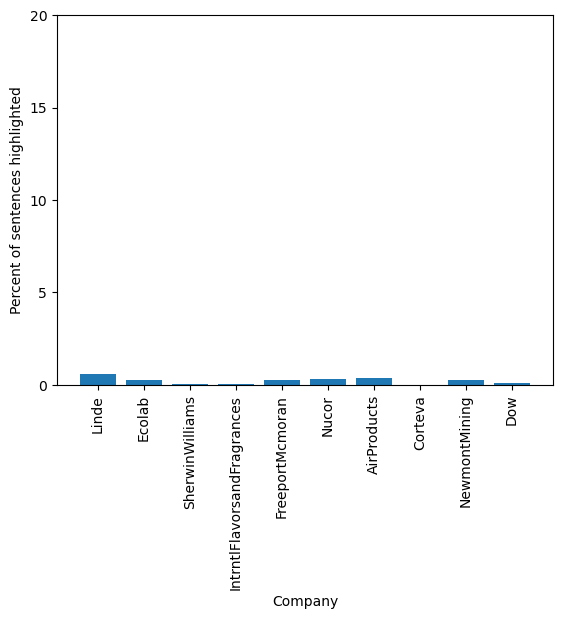

In [52]:
import matplotlib.pyplot as plt
import numpy as np
import glob
y = []

i = 0

for file in os.listdir(dir):
    y.append(100 * (rel_sent_list[i])/sentences_list[i])
    i = i+1

plt.bar(x_label, y, width = 0.8)
plt.xticks(rotation='vertical')
plt.xlabel("Company")
plt.ylabel("Percent of sentences highlighted")
plt.yticks(np.arange(0, 25, 5))
plt.show()

In [53]:
import pandas as pd

series = pd.Series(y)
series.describe()

count    9.000000
mean     0.260273
std      0.181986
min      0.025297
25%      0.094954
50%      0.274348
75%      0.339271
max      0.609640
dtype: float64

### Exporting and Saving Files 

In [54]:
#storing variable so they can be called between notebooks (for ML and aggregate work later on)

Materials_reltext = rel_text_df
Materials_alltext = all_text_df
Materials_stat = final_text_stat

%store Materials_reltext
%store Materials_alltext
%store Materials_stat

Stored 'Materials_reltext' (DataFrame)
Stored 'Materials_alltext' (DataFrame)
Stored 'Materials_stat' (DataFrame)
